<a href="https://colab.research.google.com/github/ee17b031-iittp/Neural-style-transfer/blob/master/Neural_style_transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#  $Importing \, Dependencies$

In [1]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import os
import tensorflow_datasets as tfds
from collections import defaultdict
import random
from tensorflow.keras.models import Model
import time
import cv2
from tensorflow.keras.applications.vgg16 import preprocess_input
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [2]:
print(tf.__version__)

2.2.0


# $Acquiring \, Images $

In [3]:
img_height= 899
img_width= 1135

In [ ]:
from google.colab import files
files.upload()

In [4]:
def image_dec(filename):
  image = tf.io.read_file(filename)
  image = tf.image.decode_jpeg(image)
  image = tf.image.resize(image, [img_height, img_width])
  return image

In [5]:
def preprocess_image(x):
  x-tf.constant([103.939, 116.779, 123.68])
  return x[:, :, :, ::-1]

In [6]:
def deprocess_image(x):
  x = x[:, :, ::-1]
  x[:, :, 0] += 103.939
  x[:, :, 1] += 116.779
  x[:, :, 2] += 123.68
  x = np.clip(x, 0, 255).astype('uint8')
  return x

# $ Model \, used \, for  \, style \, transfer $

In [7]:
inputs = tf.keras.Input((img_height,img_width,3), name='Input')
model=tf.keras.applications.VGG19(include_top=False,weights='imagenet',
                                  input_tensor=inputs)

In [8]:
model.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input (InputLayer)           [(None, 899, 1135, 3)]    0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 899, 1135, 64)     1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 899, 1135, 64)     36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 449, 567, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 449, 567, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 449, 567, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 224, 283, 128)     0     

# $ Neural \, style \, transfer \, algorithm $

In [22]:
def nst(content_image, style_image, alpha,beta, gamma, iterations):
  """
  Input:
        content_image: tensor, resized content image
        style_image: tensor, resized style image
        alpha: hyperparameter of loss function(content loss)
        beta: hyperparameter of loss function(style loss)
        gamma: hyperparameter of loss function(variation loss)
        iterations: number of iterations the style transfer algorithm will run
  Return:
        plots of generated image at every 20 iterations
  """
  opt = tf.keras.optimizers.Adam(learning_rate=1.0)
  noise_ratio = 0.6

  # reshaping and preprocessing the content image
  content_image = preprocess_image(tf.reshape(tf.cast(content_image,tf.float32), shape=[1, img_height, img_width, 3]))

  #noisy image or the the target generation image initialisation
  generated_image = tf.random.normal([img_height, img_width, 3], -20, 20, tf.float32)
  generated_image = tf.reshape(tf.cast(generated_image,tf.float32), shape=[1,img_height, img_width, 3])
  generated_image = (generated_image * noise_ratio + content_image * (1 - noise_ratio))

  #reshaping and preprocesing style image
  style_image = preprocess_image(tf.reshape(tf.cast(style_image,tf.float32), shape=[1,img_height, img_width, 3]))

  def grad_function(imggen,img_con, img_st, alpha, beta, gamma):
    """
    Inputs: 
            imggen: tf.Variable, contains generated image
            img_con: tensor, preprocessed contrast image
            img_st: tensor, preprocessed style image
            alpha: hyperparameter of the loss function(content)
            beta : hyperparameter of the loss function(style)
            gamma: hyperparameter of the loss function(variation)

    Returns:
            grads: tensor, gradients obtained after differentiating the style transfer loss
            loss: tensor, loss obtained at each iteration
    """
    output_layers =[]
    i = 1
    for layer in model.layers:
      if layer._name=='block'+str(i)+'_conv1':
        output_layers.append(layer)
        i+=1
    
    intermediate_layer_model = Model(inputs = model.input, outputs=[model.get_layer(layer._name).output for layer in output_layers])

    imgcon = tf.Variable(img_con)
    imgst = tf.Variable(img_st)
    with tf.GradientTape() as tape:
      tape.watch(imggen)
      predictions_content = intermediate_layer_model(imgcon)
      predictions_style = intermediate_layer_model(imgst)
      predictions_generated = intermediate_layer_model(imggen)

      def gram_matrix(mat):
        """
        Input:
              mat: tensor, feature vector obtained from the target layers
        Returns:
              gram_mat: tensor, gram matrix of input mat
        """
        m, n_h, n_w, n_c = mat.get_shape()
        mat_unrolled = tf.reshape(tf.transpose(mat), shape= [n_c, n_h*n_w])
        gram_mat = tf.matmul(mat_unrolled, tf.transpose(mat_unrolled))
        return gram_mat
      def total_variation_loss(x):
         """
        Input:
              x: tensor, generated image
        Returns:
              variation loss: tensor
        """
        height = img_height
        width = img_width
        a=tf.square(x[:,:height-1,:width-1,:]-x[:,1:,:width-1,:])
        b = tf.square(x[:, :height-1, :width-1, :] - x[:, :height-1, 1:, :])
        return tf.reduce_sum((a + b)**1.25)
      
      content_loss = tf.constant(0.0)
      style_loss = tf.constant(0.0)

      for idx in range(len(output_layers)):
        
        m, n_h, n_w, n_c = predictions_generated[idx].get_shape()
        content_loss = tf.add(content_loss, (1/(4*n_h*n_w*n_c))* tf.reduce_sum(tf.square(tf.subtract(predictions_content[idx], predictions_generated[idx]))))
        
          
        gen_grammat = gram_matrix(predictions_generated[idx])
        style_grammat = gram_matrix(predictions_style[idx])
        
        style_loss = tf.add(style_loss,(1/(4*((n_h*n_w*n_c)**2)))*(1/len(output_layers))*tf.reduce_sum(tf.square(tf.subtract(style_grammat, gen_grammat))))

      
      total_loss = (alpha* content_loss + beta *style_loss + gamma * total_variation_loss(imggen))
      grads = tape.gradient(total_loss, imggen)
    return grads,total_loss

  imggen = tf.Variable(generated_image)
  k = 0
  for iters in range(iterations):
    
    grads, loss = grad_function(imggen,content_image, style_image, alpha = alpha , beta = beta, gamma = gamma)
    opt.apply_gradients(zip(tf.expand_dims(grads, axis = 0), [imggen]))
    generated_image = imggen
    if (iters%20 ==0):
      plt.figure(k, figsize = (10,10))
      plt.imshow(deprocess_image(generated_image.numpy()[0]))
      plt.title("iter = "+str(iters)+", loss = "+str(loss.numpy()))
      k+=1

# $ Results $

* Input Images

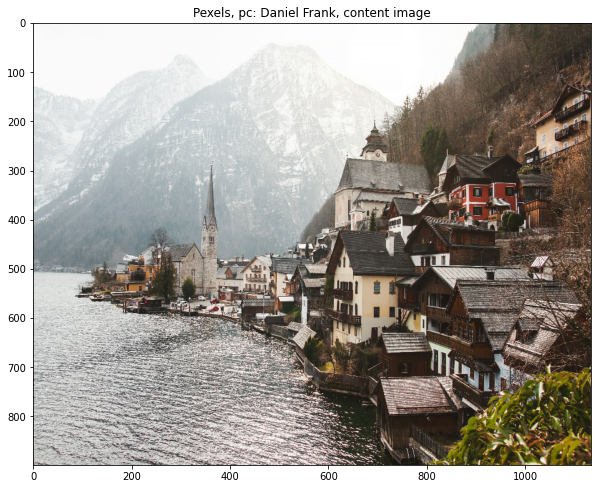

In [23]:
content_image = image_dec('/content/pexels-daniel-frank-356807.jpg')
plt.figure(figsize = (10,10))
plt.title('Pexels, pc: Daniel Frank, content image')
plt.imshow(content_image.numpy().astype("uint8") )

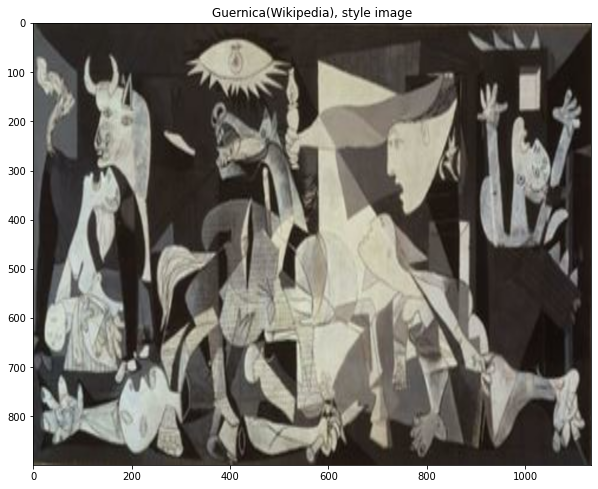

In [24]:
style_image = image_dec('/content/guernica.jpg')
plt.figure(figsize = (10,10))
plt.title('Guernica(Wikipedia), style image')
plt.imshow(style_image.numpy().astype("uint8"))

* Images obtained after style transfer

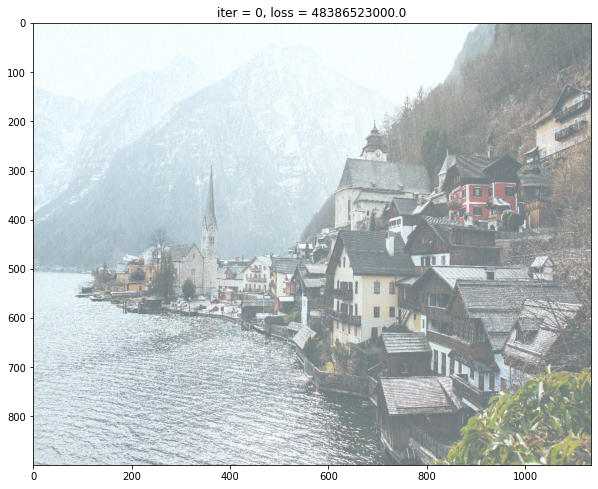

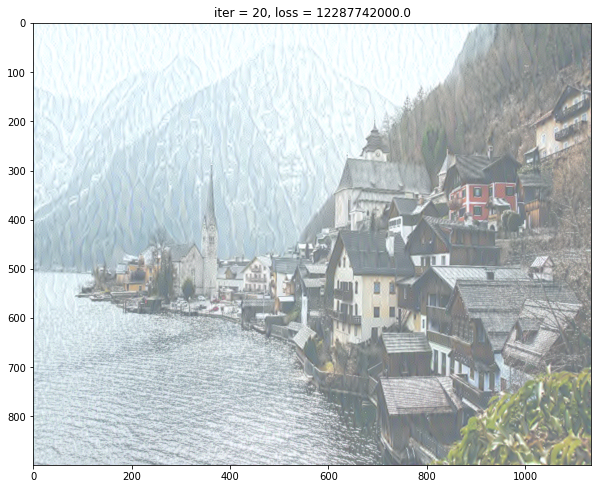

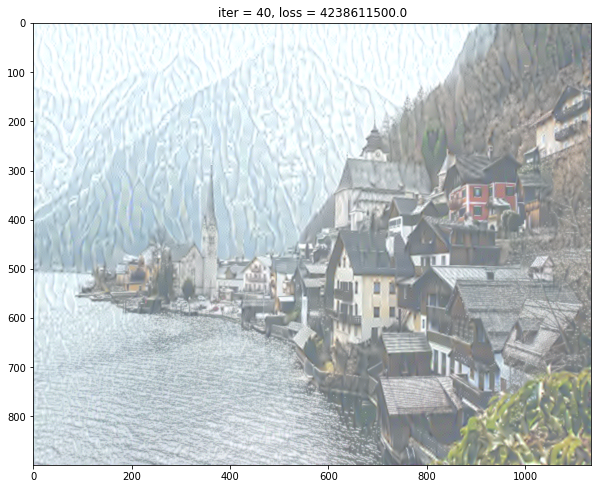

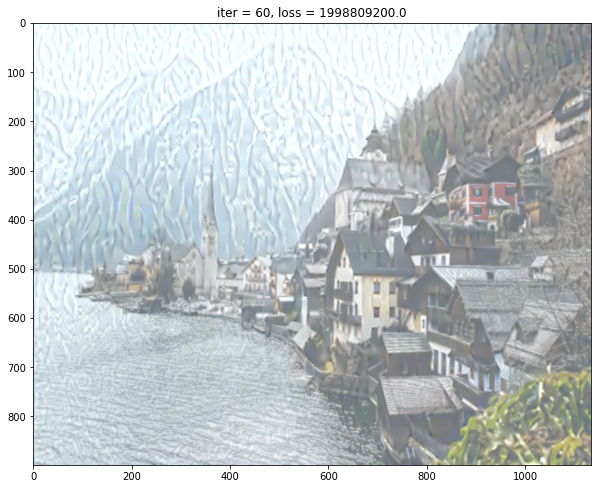

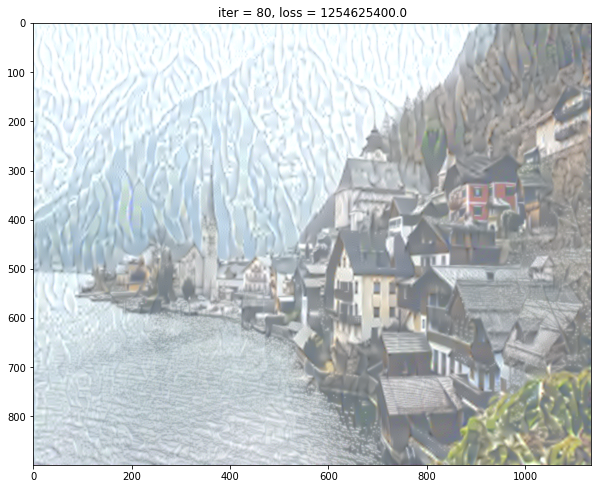

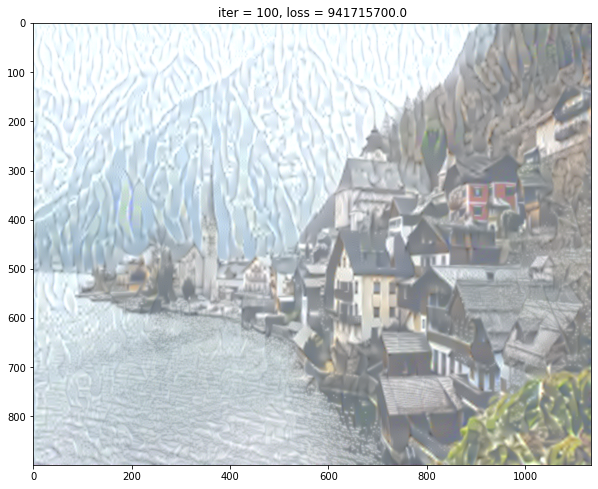

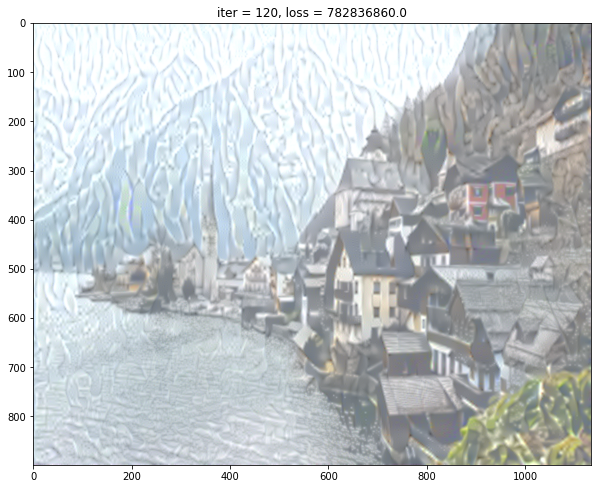

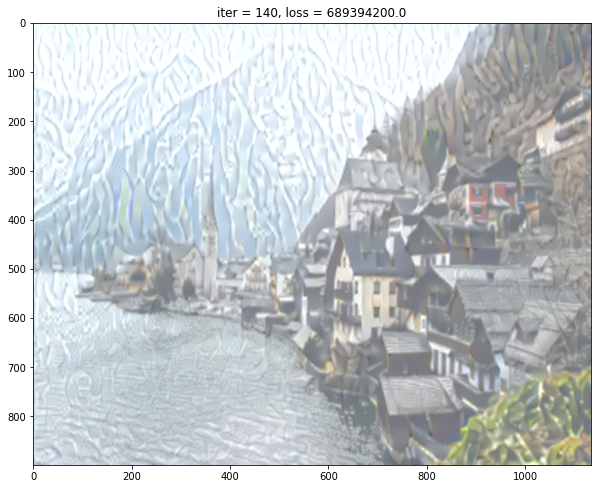

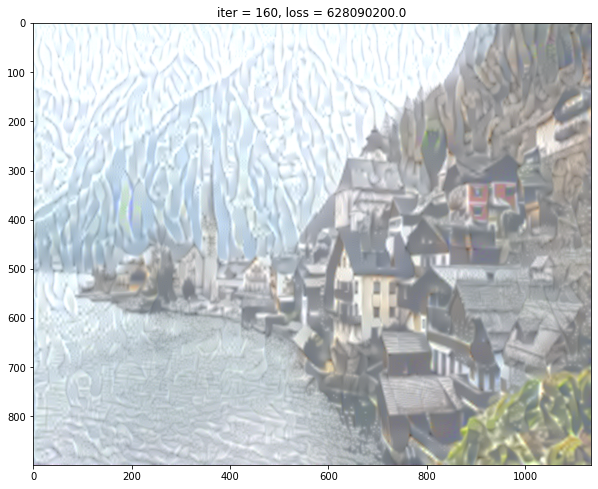

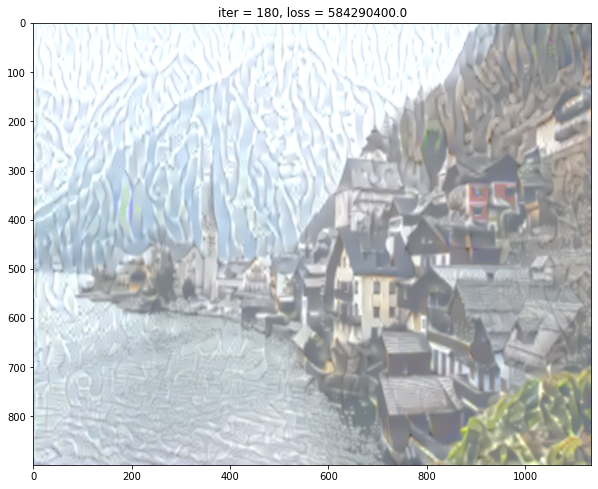

In [12]:
nst(content_image, style_image, 0.05, 5, 1, 200)

* Input Images

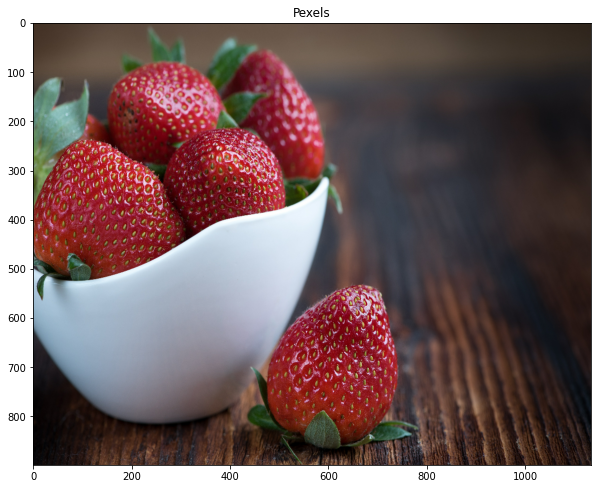

In [13]:
content_image = image_dec('/content/pexels-pixabay-89778.jpg')
plt.figure(figsize = (10,10))
plt.title('Pexels, content image')
plt.imshow(content_image.numpy().astype("uint8") )

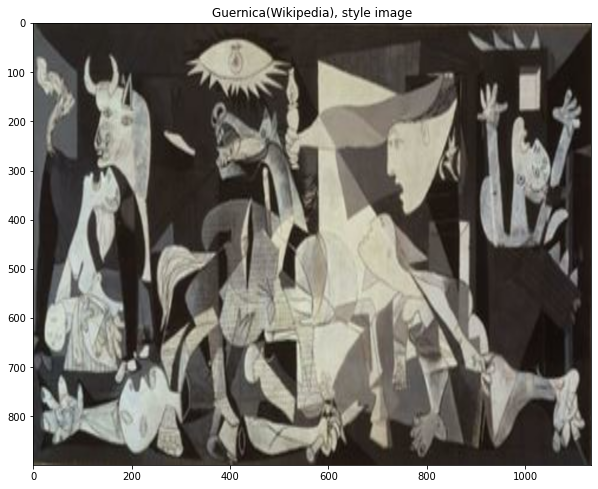

In [25]:
style_image = image_dec('/content/guernica.jpg')
plt.figure(figsize = (10,10))
plt.title('Guernica(Wikipedia), style image')
plt.imshow(style_image.numpy().astype("uint8"))

Images obtained after style transfer

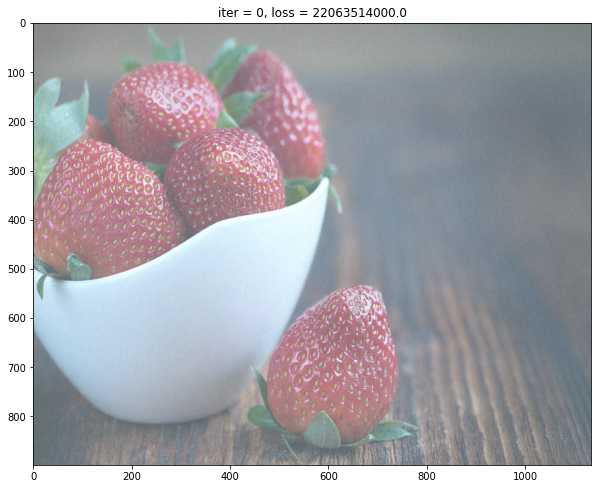

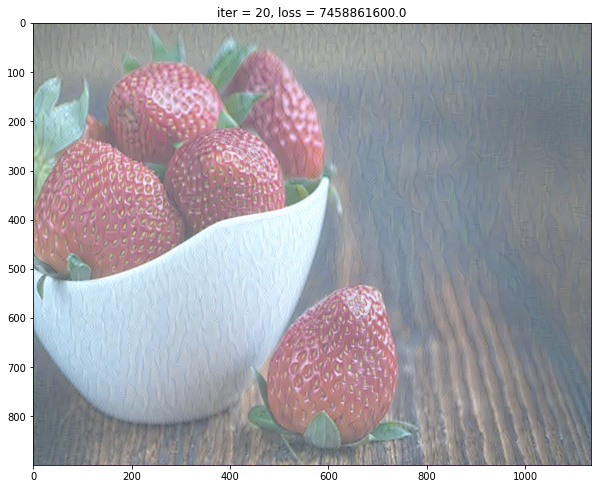

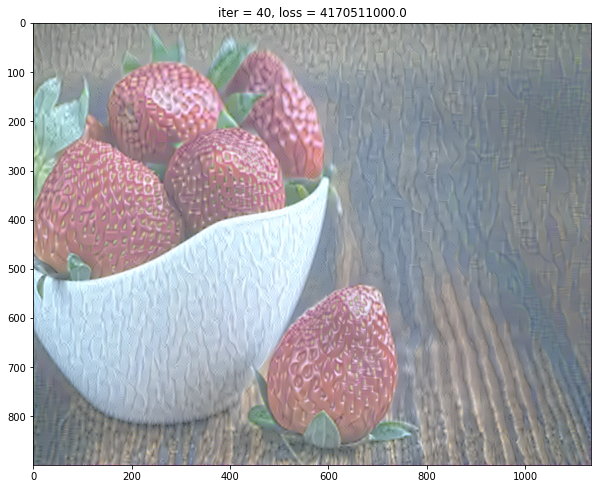

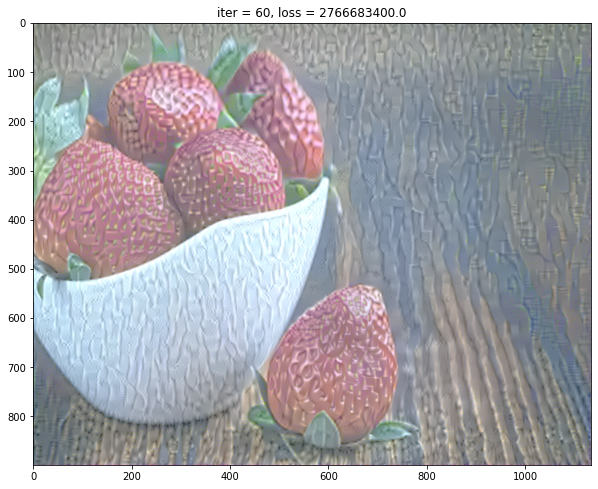

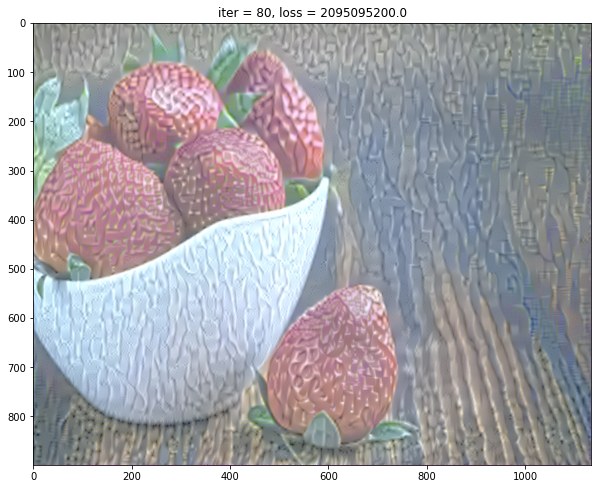

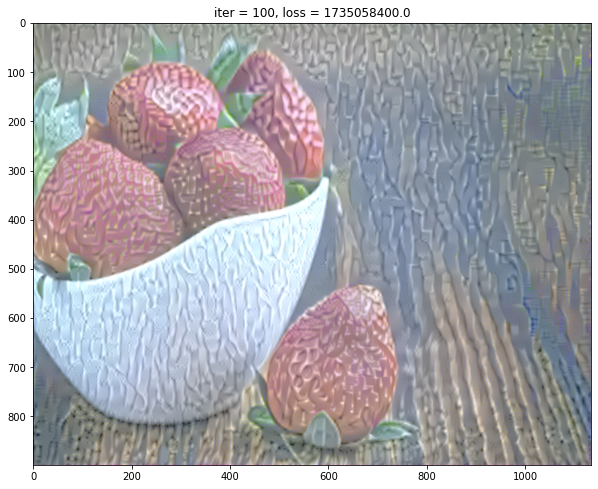

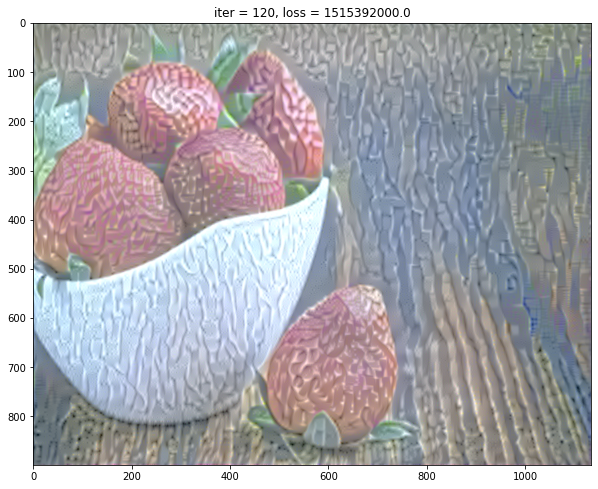

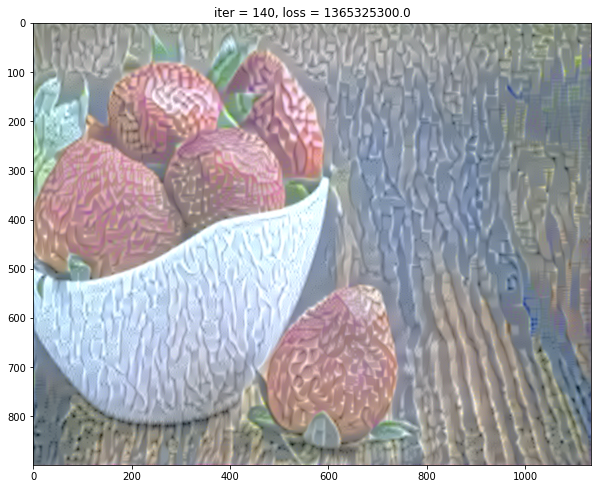

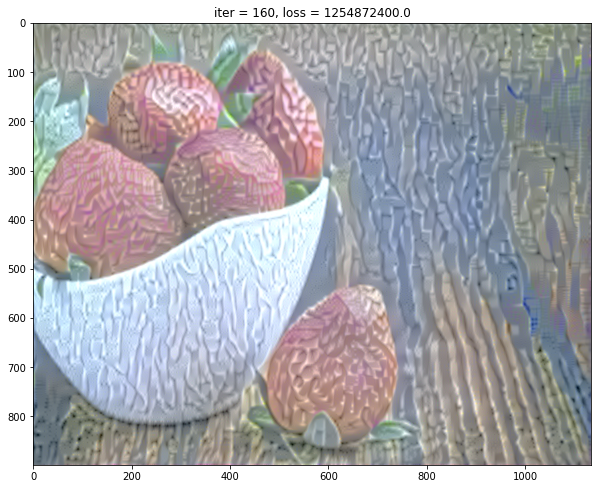

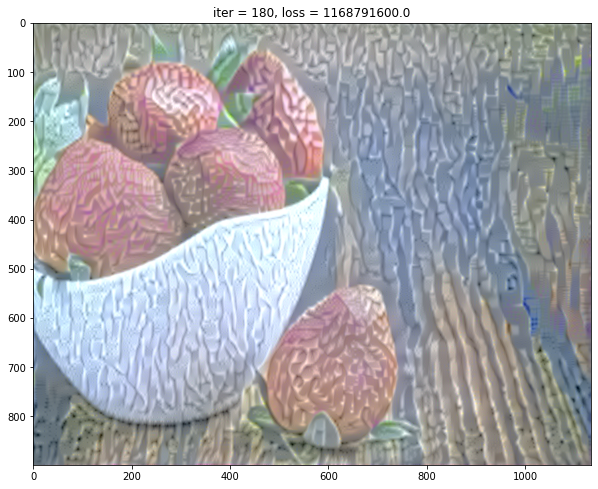

In [15]:
nst(content_image, style_image, 0.05, 5, 1, 200)

* Input Images

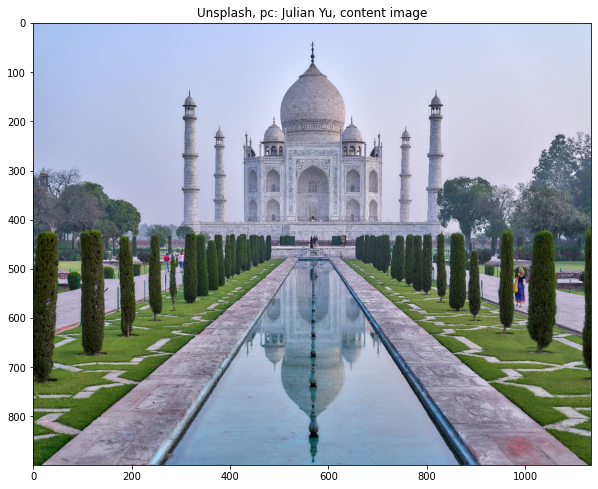

In [26]:
content_image = image_dec('/content/julian-yu-_WuPjE-MPHo-unsplash.jpg')
plt.figure(figsize = (10,10))
plt.title('Unsplash, pc: Julian Yu, content image')
plt.imshow(content_image.numpy().astype("uint8") )

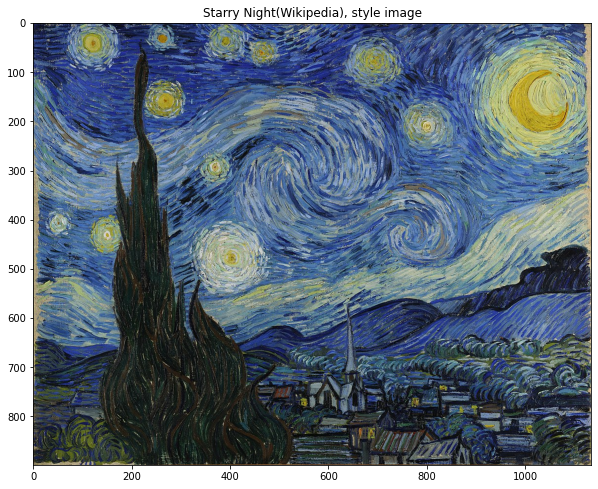

In [27]:
style_image = image_dec('/content/starry_night.jpg')
plt.figure(figsize = (10,10))
plt.title('Starry Night(Wikipedia), style image')
plt.imshow(style_image.numpy().astype("uint8"))

Images obtained after style transfer

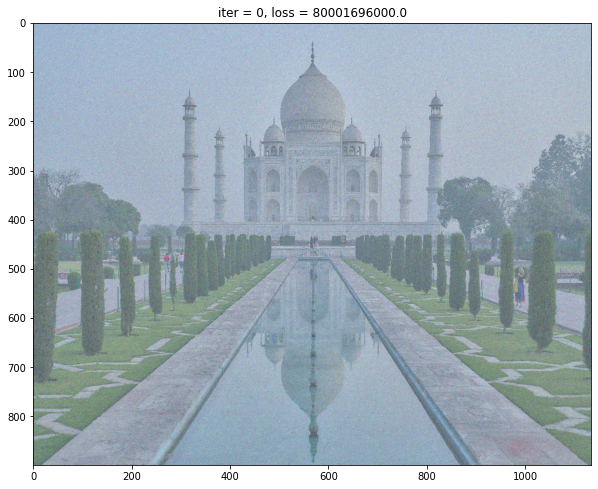

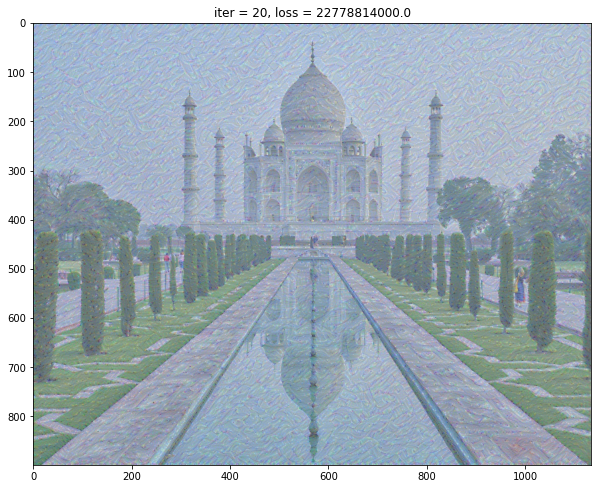

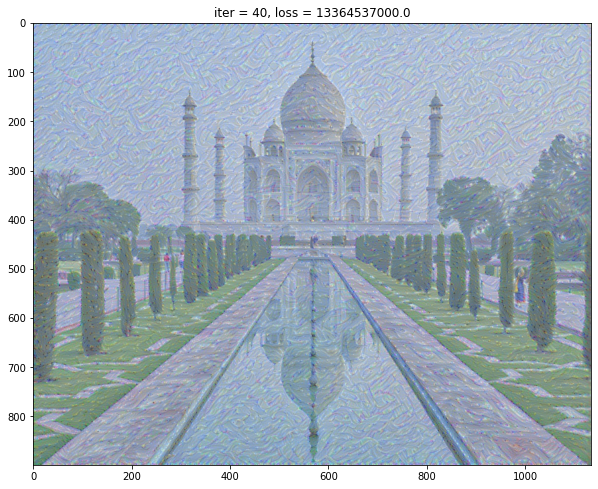

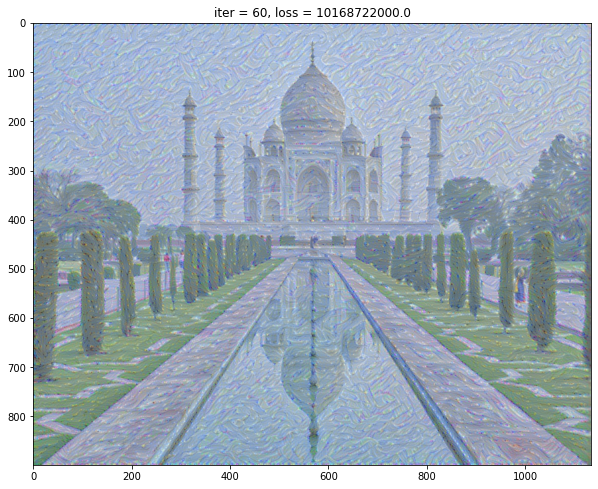

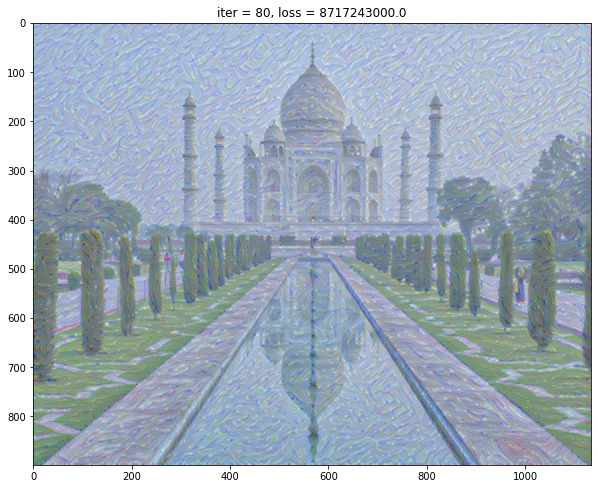

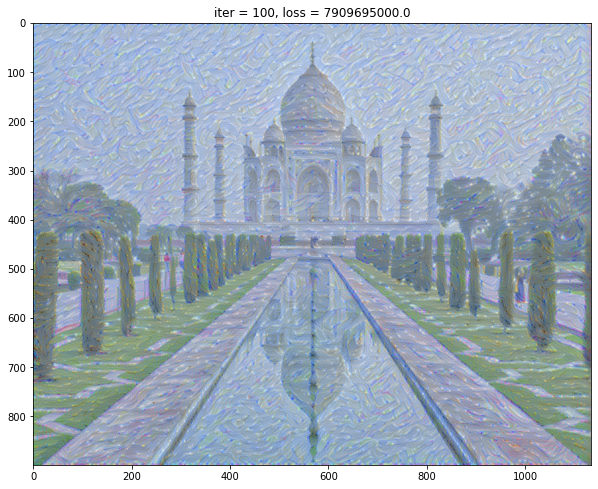

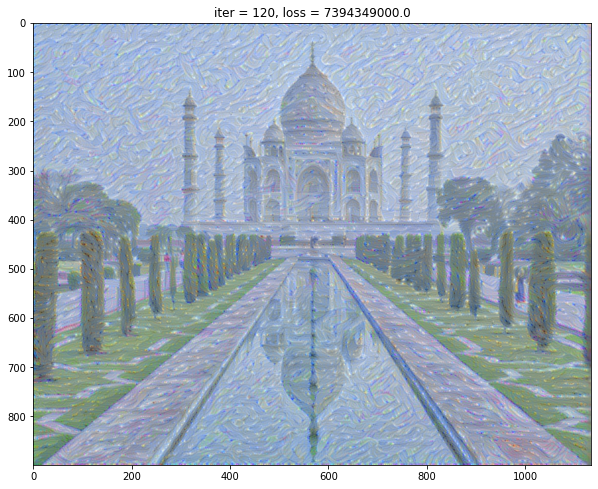

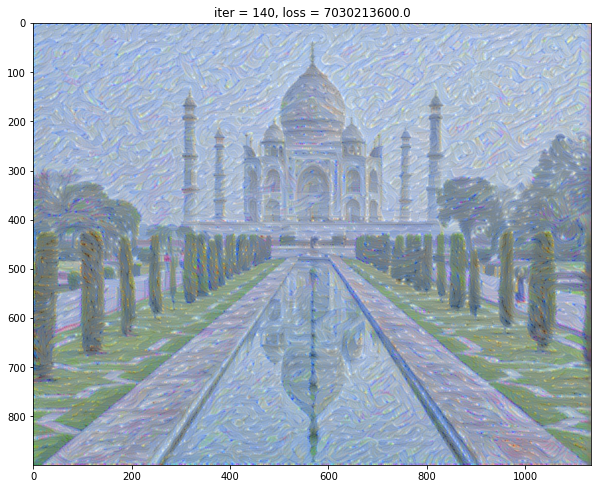

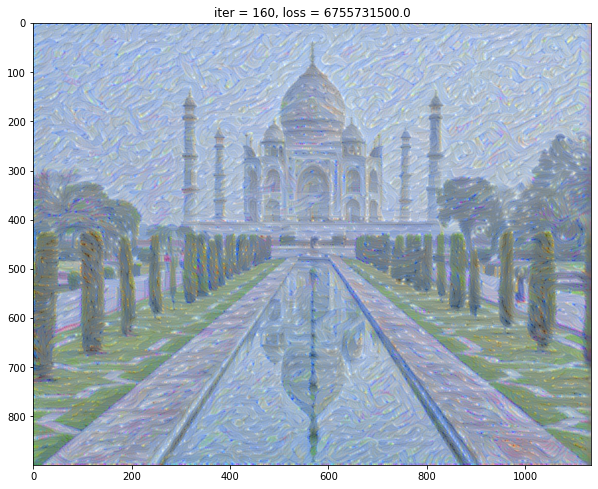

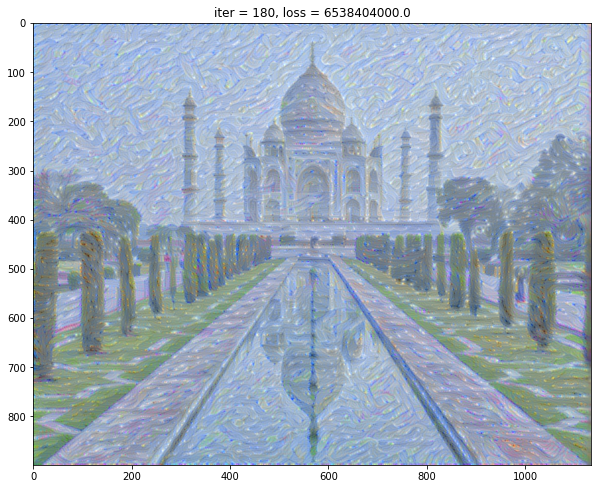

In [28]:
nst(content_image, style_image, 0.05, 5, 2, 200)